# Project_"breast-cancer-wisconsin"

# [데이터셋 설명]
##### ㅇ데이터명 : 위스콘신 유방암 진단 데이터
##### ㅇ레코드 수 : 569개
##### ㅇ컬럼 개수 : 33개(ID, 진단결과, 30개의 실측값)
##### ㅇ 위스콘신 유방암 데이터 세트는 종양의 크기, 모양 등의 다양한 속성 값을 기반으로 해당 종양이 악성(malignmant)인지 양성(benegn)인지를 분류한 데이터 세트이다.
##### ㅇ 데이터셋의 첫 두 컬럼에는 샘플의 고유 id 번호와 진단결과(M=악성=암, B=양성=정상)가 들어있습니다.
##### ㅇ 3번째에서 33번재까지 컬럼에는 세포 핵의 디지털 이미지에서 계산된 30개의 실수값 특성이 입력되어 있습니다.
##### ㅇ 최종적으로 각 특성을 이용하여 종양이 악성인지, 양성인지 예측하는 모델을 구축합니다.

In [1]:
!pip install imblearn

# [라이브러리 준비]

In [2]:
## 1. 기본
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from matplotlib import font_manager, rc
font_name = font_manager.FontProperties(fname="c:/Windows/Fonts/malgun.ttf").get_name()
rc('font', family=font_name) # 한글 출력 설정 부분

## 2. 데이터 가져오기
import pandas as pd
from sklearn import datasets

## 3. 훈련/검증용 데이터 분리
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split

## 4. 분류모델구축
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from xgboost.sklearn import XGBClassifier

## 4_1 앙상블 모델 구축
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import RandomForestClassifier

## 5. 모델검정
from sklearn.metrics import ConfusionMatrixDisplay# 정오분류표
from sklearn.metrics import accuracy_score, precision_score, f1_score, roc_auc_score, recall_score # 정확도, 민감도 등
from sklearn.metrics import roc_curve, auc #  roc 곡선 그리기

## 6. 최적화
from sklearn.model_selection import learning_curve, validation_curve # 학습곡선, 검증곡선
from sklearn.model_selection import GridSearchCV #  하이퍼파라미터 튜닝
from sklearn.model_selection import cross_val_score # 교차타당도 # 추가

# [데이터 준비 및 확인]

## 1. 데이터 준비(데이터 로딩)

In [3]:
# Load data

df=pd.read_csv('breast_cancer_wisconsin.csv', encoding='utf-8')

## 2. 데이터 확인

### 2.1. 데이터 확인

In [4]:
print(df.shape)

(569, 33)


In [5]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [6]:
# 특성 : 설명
# id : 환자 식별 번호
# dignosis : 유방암 종양(M=악성, B=양성)
# radius : 세포의 크기
# texture : 질감(흑백 처리했을때의 표준편차 값으로 계산)
# perimeter : 둘레
# area : 면적
# smoothness : 매끄러움(반경의 국소적 변화 측정)
# compactness : 작은 정도(perimeter2/area−1로 계산)
# concavity : 오목함(윤곽의 오목한 부분의 정도)
# concave points : 오목한곳의 수
# symmetry : 대칭성
# fractal dimension : 프랙탈 차원(coastlineapproximation−1로 계산)

In [7]:
# 데이터들을 확인해 보면 종양의 크기와 모양에 관련된 속성들이 숫자형태(float)로 구성되어 있으며, 
# 타깃(y)값인 diagnosis는 문자형태(object)로 구성되어 있음을 확인하였음.

In [8]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [9]:
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [10]:
df.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [11]:
# 결측값을 확인해 보았을 때 결측값이 없음을 확인하였다.
# 'Unnamed : 32'는 원본데이터를 확인해 봤을 때 불필요한 columns이므로 drop 시키는 작업을 진행한다.
# 삭제 예정 컬럼 : 'id', 'diagnosis', 'Unnamed: 32'

In [12]:
df['diagnosis'].value_counts(sort=False)

M    212
B    357
Name: diagnosis, dtype: int64

In [13]:
# 'M'(malignant/악성종양=유방암환자)= 212
# 'B'(benign/양성종양=정상)= 357

### 2.2. 데이터 시각화

In [14]:
sns.pairplot(vars=["radius_mean", 
                   "texture_mean", 
                   "perimeter_mean", 
                   "area_mean", 
                   "smoothness_mean", 
                   "compactness_mean", 
                   "concavity_mean", 
                   "concave points_mean", 
                   "symmetry_mean", 
                   "fractal_dimension_mean", 
                   "radius_se", 
                   "texture_se", 
                   "perimeter_se", 
                   "area_se", 
                   "smoothness_se", 
                   "compactness_se", 
                   "concavity_se", 
                   "concave points_se", 
                   "symmetry_se", 
                   "fractal_dimension_se", 
                   "radius_worst", 
                   "texture_worst", 
                   "perimeter_worst", 
                   "area_worst", 
                   "smoothness_worst", 
                   "compactness_worst", 
                   "concavity_worst", 
                   "concave points_worst", 
                   "symmetry_worst", 
                   "fractal_dimension_worst"], 
             hue="diagnosis", data=df)
plt.show()

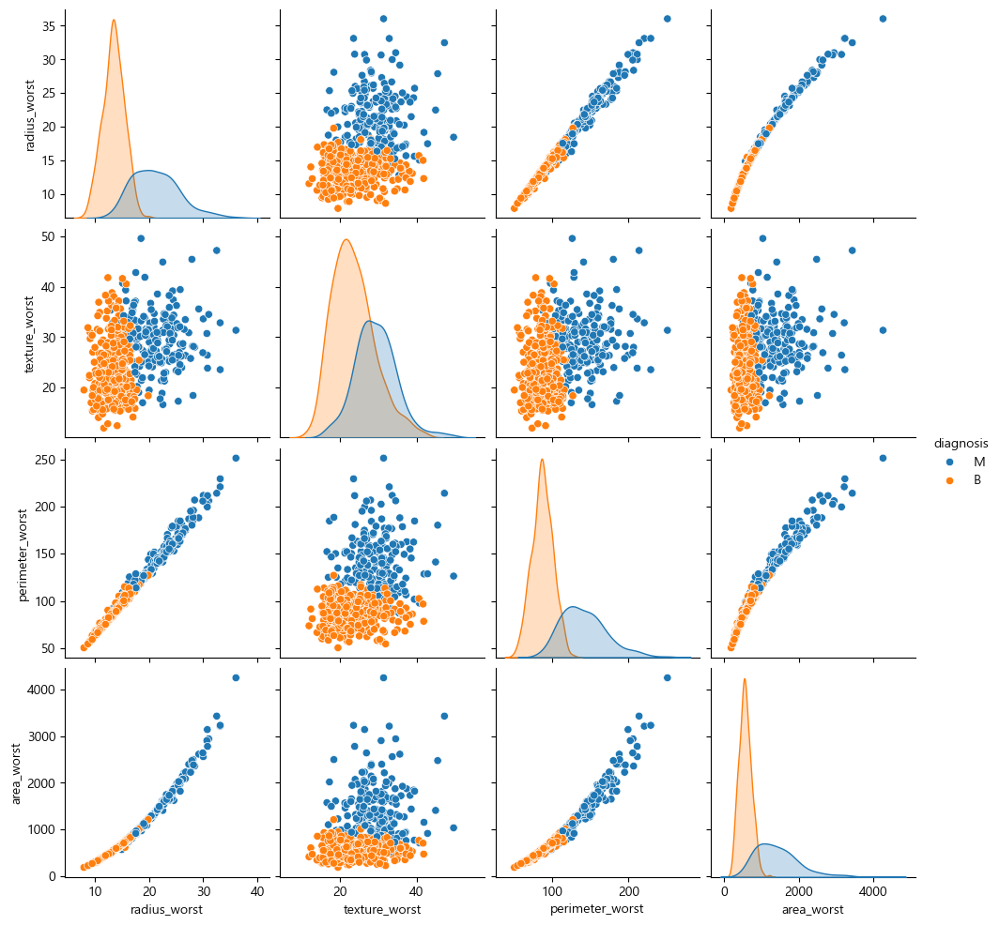

In [15]:
sns.pairplot(vars=["radius_worst", "texture_worst", "perimeter_worst", "area_worst"], 
             hue="diagnosis", data=df)
plt.show()

# [데이터 전처리]

## 1. 원-핫 인코딩 (One-Hot Encoding))

In [16]:
df['diagnosis'].unique()

array(['M', 'B'], dtype=object)

In [17]:
# unique()를 사용해서 df[diagnosis]에 있는 값을 특성을 확인해 보면 'M'(malignant)와 'B'(benign)라는 문자형태의 값으로 이루어져 있음을 확인 하였다.
# 'M'(malignant)=1, 'B'(benign)=0으로 변환해준다.
# 보편적으로 관심 있게 보는 항목을 1로 설정하는 것으로 하여, '악성 종양(=암)'을 1로 설정하였다.
# malignant : 악성종양, benign : 양성종양

In [18]:
def func1(row) :
    if 'M' in row :
        return 1
    else :
        return 0
df['판정'] = df['diagnosis'].apply(func1)
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32,판정
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN,1
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN,1
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN,1
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN,1
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN,1


In [19]:
# 함수를 사용하여 0과 1로 변환한 후, 변환된 결과를 df 데이터프레임에 '판정'이라는 새로운 columns를 만들어 입력함.

## 2. 필요없는 컬럼 drop 하기

In [20]:
total = df.drop(columns=['id', 'diagnosis', 'Unnamed: 32'])
total.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,판정
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1


## 3. train / test data set 분할

In [21]:
X = total.drop(['판정'], axis=1)
y = total['판정']

In [22]:
# 전체 데이터프레임 'total'에서 타겟값(columns['판정'])을 제외한 나머지 columns을 X로 설정
# total['판정']을 y로 설정

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=1234, stratify=y)

In [24]:
# train_test_split를 이용하여 7:3의 비율로 train set, test set를 분할한다.

In [25]:
print(X_train.shape, X_test.shape)

(398, 30) (171, 30)


## 4. minmax 정규화(Standard  정규화 포함)

In [26]:
scaler_minmax = MinMaxScaler()
scaler_stand = StandardScaler()

scaler_minmax.fit(X_train)
x_minmax_train = scaler_minmax.transform(X_train)
x_minmax_test = scaler_minmax.transform(X_test)

scaler_stand.fit(X_train)
x_stand_train = scaler_stand.transform(X_train)
x_stand_test = scaler_stand.transform(X_test)

pd.DataFrame(x_minmax_train).describe()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
count,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,...,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000
mean,0.339796,0.373684,0.334363,0.217719,0.391879,0.278350,0.205274,0.240503,0.379111,0.261250,...,0.296278,0.353432,0.282635,0.170173,0.401033,0.218152,0.230346,0.389570,0.262019,0.186520
std,0.163912,0.182241,0.164912,0.150156,0.127823,0.178433,0.187240,0.192830,0.140203,0.151775,...,0.168607,0.165340,0.164139,0.140085,0.151860,0.150018,0.175065,0.223331,0.123420,0.120515
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.229968,0.238288,0.223654,0.121389,0.304685,0.148111,0.067045,0.100422,0.282955,0.153072,...,0.183654,0.226721,0.169680,0.082666,0.294889,0.117696,0.093462,0.218325,0.180170,0.101830
50%,0.306404,0.357268,0.299323,0.173680,0.383001,0.239912,0.142561,0.164140,0.371717,0.233581,...,0.250623,0.344265,0.235943,0.123599,0.391798,0.178091,0.195726,0.347423,0.247092,0.162206
75%,0.410171,0.484895,0.412964,0.261771,0.468945,0.367013,0.284560,0.349167,0.451010,0.333263,...,0.365261,0.454049,0.363888,0.206154,0.486892,0.292696,0.325278,0.549141,0.319338,0.242769
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [27]:
# minmax 정규화를 실시하기 전에 아래 소스를 먼저 작업하여, 아래 소스에서는 minmax 정규화 수치가 적용되지 않았습니다.

# [모델구축]

## 1. VOTING(투표) 기법

### 1.1. 모델구축_VOTING(투표) 기법

In [28]:
logistic = LogisticRegression(solver='liblinear', 
                              penalty='l2', 
                              C=0.001, 
                              random_state=1)
tree = DecisionTreeClassifier(max_depth=None,
                              criterion='entropy',
                              random_state=1)
voting_estimators = [('logistic', logistic), ('tree', tree)]
voting = VotingClassifier(estimators=voting_estimators, 
                          voting='soft')
clf_labels = ['Logistic regression', 'Decision tree', 'Majority voting']
all_clf = [logistic, tree, voting]

In [29]:
# logistic, tree, knn(k-최근접 이웃)에 대한 모델링을 시행하였다.

In [30]:
# 보팅 유형에는 예측한 결과값 중 다수의 분류기가 결정한 예측값을 최종 보팅 결과값으로 선정하는 하드보팅과 
# 분류기들의 레이블 값 결정 확률을 모두 더하여 이를 평균내어 확률이 가증 높은 레이블을 최종 보팅 결과값으로 선정하는 소프트보팅이 있다.
# 일반적으로 소프트 보팅이 적용된다.

### 1.2. AUC 검정_VOTING(투표) 기법

In [31]:
for clf, label in zip(all_clf, clf_labels):
    scores = cross_val_score(estimator=clf,
                             X=X_train,
                             y=y_train,
                             cv=10, 
                             scoring='roc_auc')
    print("ROC AUC: %0.3f (+/- %0.3f) [%s]" 
          % (scores.mean(), scores.std(), label))

ROC AUC: 0.960 (+/- 0.027) [Logistic regression]
ROC AUC: 0.929 (+/- 0.043) [Decision tree]
ROC AUC: 0.981 (+/- 0.017) [Majority voting]


In [32]:
# AUC 결과
# 로지스틱 회귀분석은 96%, 
# 의사결정 나무는 92%,
# 투표기법을 사용한 결과는 98%로 투표기법을 사용했을 때 모델 성능이 가장 좋다는 것을 확인하였다.

### 1.3. ROC 곡선_VOTING(투표) 기법

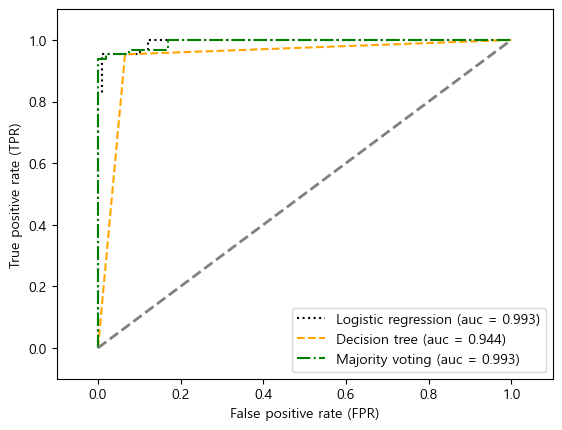

In [33]:
colors = ['black', 'orange', 'green']
linestyles = [':', '--', '-.', '']

for clf, label, clr, ls \
        in zip(all_clf, clf_labels, colors, linestyles):
    clf.fit(X_train, y_train)
    y_pred = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(y_true=y_test,
                                     y_score=y_pred)
    roc_auc = auc(x=fpr, y=tpr)
    plt.plot(fpr, tpr,
            color=clr,
            linestyle=ls,
            label='%s (auc = %0.3f)' % (label, roc_auc))
    
plt.legend(loc='lower right')
plt.plot([0, 1], [0, 1],
        linestyle='--',
        color='gray',
        linewidth=2)

plt.xlim([-0.1, 1.1])
plt.ylim([-0.1, 1.1])
plt.xlabel('False positive rate (FPR)')
plt.ylabel('True positive rate (TPR)')

plt.show()

## 2. 배깅-랜덤 포레스트 기법

### 2.1. 모델구축_배깅-랜덤 포레스트 기법

In [34]:
tree = DecisionTreeClassifier(max_depth=None,
                              criterion='entropy',
                              random_state=1)
forest = RandomForestClassifier(criterion='gini',
                                n_estimators=500,
                                random_state=1)
clf_labels = ['Decision tree', 'Random forest']
all_clf = [tree, forest]

In [35]:
# 배깅기법은 여러가지 분류 모델 중 한 가지 모델에만 집중하여 모델을 구축하는 것이다.
# 이때 의사결정 나무만을 구축하게 되면, '랜덤 포레스트'라고 부르게 된다.
# 랜덤 포레스트 모델을 구축시 n_estimators는 '데이터 샘플을 몇 개까지 만들것인가' 라는 의미이다.
# n_estimators=500 이라는 것은 의사결정나무를 500개 만든다는 내용이다.

### 2.2. AUC 검정_배깅-랜덤 포레스트 기법

In [36]:
for clf, label in zip(all_clf, clf_labels):
    scores = cross_val_score(estimator=clf,
                             X=X_train,
                             y=y_train,
                             cv=10, 
                             scoring='roc_auc')
    print("ROC AUC: %0.3f (+/- %0.3f) [%s]" 
          % (scores.mean(), scores.std(), label))

ROC AUC: 0.929 (+/- 0.043) [Decision tree]
ROC AUC: 0.990 (+/- 0.016) [Random forest]


In [37]:
# AUC 결과
# 의사결정 나무는 92%, 
# 랜덤포레스트는 99%로 랜덤포레스트 기법을 사용했을 때 모델 성능이 가장 좋다는 것을 확인하였다.

### 2.3. ROC 곡선_배깅-랜덤 포레스트 기법

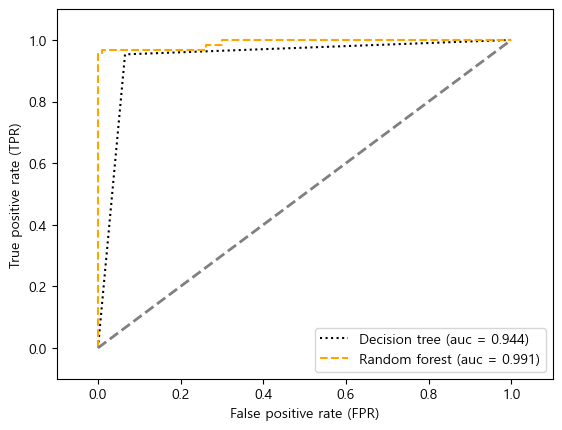

In [38]:
colors = ['black', 'orange', 'green']
linestyles = [':', '--', '-.', '']

for clf, label, clr, ls \
        in zip(all_clf, clf_labels, colors, linestyles):
    clf.fit(X_train, y_train)
    y_pred = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(y_true=y_test,
                                     y_score=y_pred)
    roc_auc = auc(x=fpr, y=tpr)
    plt.plot(fpr, tpr,
            color=clr,
            linestyle=ls,
            label='%s (auc = %0.3f)' % (label, roc_auc))
    
plt.legend(loc='lower right')
plt.plot([0, 1], [0, 1],
        linestyle='--',
        color='gray',
        linewidth=2)

plt.xlim([-0.1, 1.1])
plt.ylim([-0.1, 1.1])
plt.xlabel('False positive rate (FPR)')
plt.ylabel('True positive rate (TPR)')

plt.show()

## 3. Adaboost(부스팅) 기법

### 3.1. 모델구축_Adaboost(부스팅) 기법

In [39]:
tree = DecisionTreeClassifier(max_depth=1, #수정
                              criterion='entropy',
                              random_state=1)
adaboost = AdaBoostClassifier(estimator=tree,  # estimator로 변경
                              n_estimators=500,
                              learning_rate=0.1,
                              random_state=1)
clf_labels = ['Decision tree', 'Ada boost']
all_clf = [tree, adaboost]

In [40]:
# 의사결정나무와 AdaBoost 기법을 이용하여 모델을 구축하였다.

### 3.2. AUC 검정_Adaboost(부스팅) 기법

In [41]:
for clf, label in zip(all_clf, clf_labels):
    scores = cross_val_score(estimator=clf,
                             X=X_train,
                             y=y_train,
                             cv=10, 
                             scoring='roc_auc')
    print("ROC AUC: %0.3f (+/- %0.3f) [%s]" 
          % (scores.mean(), scores.std(), label))

ROC AUC: 0.905 (+/- 0.049) [Decision tree]
ROC AUC: 0.993 (+/- 0.009) [Ada boost]


In [42]:
# 의사결정나무만을 사용했을 때는 AUC 값이 90%인 반면,
# AdaBoost를 적용했을 때는 AUC 값이 99%로 증가했음을 확인하였다.

### 3.3 ROC 곡선_Adaboost(부스팅) 기법

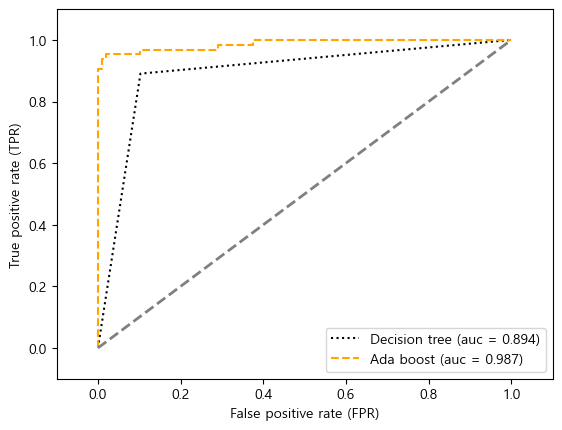

In [43]:
colors = ['black', 'orange', 'green']
linestyles = [':', '--', '-.', '']

for clf, label, clr, ls \
        in zip(all_clf, clf_labels, colors, linestyles):
    clf.fit(X_train, y_train)
    y_pred = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(y_true=y_test,
                                     y_score=y_pred)
    roc_auc = auc(x=fpr, y=tpr)
    plt.plot(fpr, tpr,
            color=clr,
            linestyle=ls,
            label='%s (auc = %0.3f)' % (label, roc_auc))
    
plt.legend(loc='lower right')
plt.plot([0, 1], [0, 1],
        linestyle='--',
        color='gray',
        linewidth=2)

plt.xlim([-0.1, 1.1])
plt.ylim([-0.1, 1.1])
plt.xlabel('False positive rate (FPR)')
plt.ylabel('True positive rate (TPR)')

plt.show()

## 4. 정오분류표로 검정(테스트 데이터 이용)

### 4.1. 정오분류표로 검정_랜덤포레스트

In [44]:
forest.fit(X_train, y_train)

y_pred = forest.predict(X_test)

print('잘못 분류된 샘플 개수: %d' % (y_test != y_pred).sum())

print('정확도: %.3f' % accuracy_score(y_test, y_pred))

print('정밀도: %.3f' % precision_score(y_true=y_test, y_pred=y_pred))

print('재현율: %.3f' % recall_score(y_true=y_test, y_pred=y_pred))

print('F1: %.3f' % f1_score(y_true=y_test, y_pred=y_pred))

잘못 분류된 샘플 개수: 5
정확도: 0.971
정밀도: 0.954
재현율: 0.969
F1: 0.961


In [45]:
# 정오분류표로 랜덤포트레스트 모델을 검정한 결과를 확인하였음.

### 4.2. 정오분류표로 검정_부스팅

In [46]:
adaboost.fit(X_train, y_train)

y_pred = adaboost.predict(X_test)

print('잘못 분류된 샘플 개수: %d' % (y_test != y_pred).sum())

print('정확도: %.3f' % accuracy_score(y_test, y_pred))

print('정밀도: %.3f' % precision_score(y_true=y_test, y_pred=y_pred))

print('재현율: %.3f' % recall_score(y_true=y_test, y_pred=y_pred))

print('F1: %.3f' % f1_score(y_true=y_test, y_pred=y_pred))

잘못 분류된 샘플 개수: 6
정확도: 0.965
정밀도: 0.953
재현율: 0.953
F1: 0.953


In [47]:
# 정오분류표로 부스팅 모델을 검정한 결과를 확인하였음.

# [최적화(튜닝)]

## 1. 하이퍼 파라미터 튜닝_투표기법

In [48]:
# 모델링 후 구축된 모델을 검정하기 위해 파이프라인을 시행하지만, 
# Voting(보팅)의 경우 보팅 자체가 파이프라인 역할을 하기 때문에 따로 파이프라인을 시행하지 않고, 바로 하이퍼파라미터 튜닝 단계를 진행함.

## 2. 파라미터 확인

In [49]:
voting.get_params()

{'estimators': [('logistic',
   LogisticRegression(C=0.001, random_state=1, solver='liblinear')),
  ('tree', DecisionTreeClassifier(criterion='entropy', random_state=1))],
 'flatten_transform': True,
 'n_jobs': None,
 'verbose': False,
 'voting': 'soft',
 'weights': None,
 'logistic': LogisticRegression(C=0.001, random_state=1, solver='liblinear'),
 'tree': DecisionTreeClassifier(criterion='entropy', random_state=1),
 'logistic__C': 0.001,
 'logistic__class_weight': None,
 'logistic__dual': False,
 'logistic__fit_intercept': True,
 'logistic__intercept_scaling': 1,
 'logistic__l1_ratio': None,
 'logistic__max_iter': 100,
 'logistic__multi_class': 'auto',
 'logistic__n_jobs': None,
 'logistic__penalty': 'l2',
 'logistic__random_state': 1,
 'logistic__solver': 'liblinear',
 'logistic__tol': 0.0001,
 'logistic__verbose': 0,
 'logistic__warm_start': False,
 'tree__ccp_alpha': 0.0,
 'tree__class_weight': None,
 'tree__criterion': 'entropy',
 'tree__max_depth': None,
 'tree__max_features': N

##### GridSearch 이용

In [50]:
params = {'logistic__C' : [0.001, 0.1, 100.0],
          'tree__max_depth' : [1, 2, 3, 4, 5]}

grid = GridSearchCV(estimator=voting,
                    param_grid=params,
                    cv=10,
                    scoring='roc_auc')
grid.fit(X_train, y_train)

for r, _ in enumerate(grid.cv_results_['mean_test_score']):
    print("%0.3f +/- %0.3f %r"
          % (grid.cv_results_['mean_test_score'][r],
             grid.cv_results_['std_test_score'][r] / 2.0,
             grid.cv_results_['params'][r]))

0.985 +/- 0.007 {'logistic__C': 0.001, 'tree__max_depth': 1}
0.986 +/- 0.008 {'logistic__C': 0.001, 'tree__max_depth': 2}
0.986 +/- 0.010 {'logistic__C': 0.001, 'tree__max_depth': 3}
0.981 +/- 0.009 {'logistic__C': 0.001, 'tree__max_depth': 4}
0.981 +/- 0.009 {'logistic__C': 0.001, 'tree__max_depth': 5}
0.992 +/- 0.005 {'logistic__C': 0.1, 'tree__max_depth': 1}
0.992 +/- 0.004 {'logistic__C': 0.1, 'tree__max_depth': 2}
0.993 +/- 0.004 {'logistic__C': 0.1, 'tree__max_depth': 3}
0.988 +/- 0.005 {'logistic__C': 0.1, 'tree__max_depth': 4}
0.988 +/- 0.005 {'logistic__C': 0.1, 'tree__max_depth': 5}
0.990 +/- 0.006 {'logistic__C': 100.0, 'tree__max_depth': 1}
0.990 +/- 0.006 {'logistic__C': 100.0, 'tree__max_depth': 2}
0.990 +/- 0.006 {'logistic__C': 100.0, 'tree__max_depth': 3}
0.988 +/- 0.008 {'logistic__C': 100.0, 'tree__max_depth': 4}
0.989 +/- 0.007 {'logistic__C': 100.0, 'tree__max_depth': 5}


## 3. 최적의 파라미터 확인

In [51]:
print('최적의 파라미터: %s' % grid.best_params_)
print('AUC: %.3f' % grid.best_score_)

최적의 파라미터: {'logistic__C': 0.1, 'tree__max_depth': 3}
AUC: 0.993


In [52]:
# grid.best_params_를 사용하여 최적의 파라미터 값을 구하고,
# 최적의 파라미터 값을 적용했을 때 나온 AUC의 값(99.3%)이 투표기법을 사용하여 분석했을 때 모델의 정확도이다.

## 4. 랜덤 포레스트_특성(피쳐) 중요도 확인

( 1) concave points_worst           0.137600
( 2) concave points_mean            0.125063
( 3) perimeter_worst                0.108051
( 4) radius_worst                   0.097582
( 5) area_worst                     0.089288
( 6) concavity_mean                 0.085380
( 7) concavity_worst                0.042184
( 8) perimeter_mean                 0.037595
( 9) area_mean                      0.037227
(10) radius_mean                    0.033160
(11) area_se                        0.031252
(12) texture_worst                  0.019756
(13) compactness_worst              0.016060
(14) smoothness_worst               0.015860
(15) texture_mean                   0.015425
(16) perimeter_se                   0.013728
(17) compactness_mean               0.012635
(18) symmetry_worst                 0.011222
(19) radius_se                      0.010675
(20) concavity_se                   0.008301
(21) smoothness_mean                0.007866
(22) fractal_dimension_worst        0.006628
(23) fract

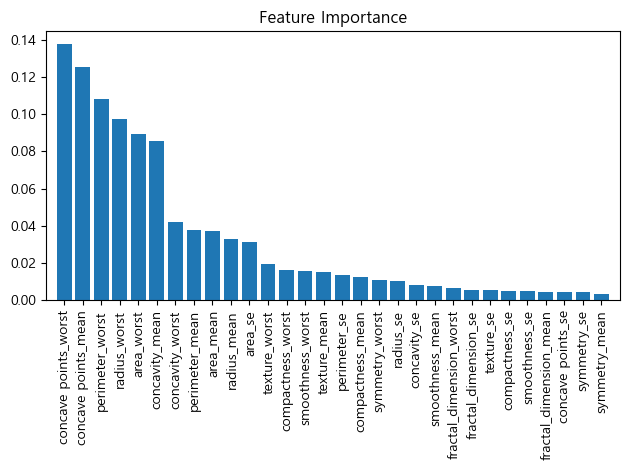

In [53]:
feat_labels = X.columns
importances = forest.feature_importances_
indices = np.argsort(importances)[::-1]

for f in range(X_train.shape[1]):
    print("(%2d) %-*s %f" % (f + 1, 30, 
                             feat_labels[indices[f]],
                             importances[indices[f]]))
plt.title('Feature Importance')
plt.bar(range(X_train.shape[1]),
        importances[indices],
        align='center')

plt.xticks(range(X_train.shape[1]),
           feat_labels[indices], rotation=90)
plt.xlim(-1, X_train.shape[1])
plt.tight_layout()
plt.show()

In [54]:
# 랜덤포레스트 모델 구축단계에서 랜덤포레스트 샘플을 500개 만들었다.
# 샘플을 500개 만든다는 것은 나무의 가지가 1개일 때 부터 여러 개일 때까지 무수히 많은 옵션을 만든다는 것이고,
# 이렇게 만들어진 샘플 중 최적의 브런치(가지)들 모아서 하나의 최적의 모델을 맏는 것이 랜덤포레스트의 원리이다.
# 때문에 랜덤포레스트 기법을 사용시 별도의 파라미터 튜닝을 진행하지 않았다.(필요성이 없음)
# 위의 표를 통해 특성(피쳐, X) 별로 타겟값(y)에 미치는 중요도(영향도)를 확인하였다.
# 수치 및 바그래프를 통해 "concave points_worst"의 영향도가 가장 높은 것을 확인하였다.